In [1]:
from PIL import Image
from helpers.arch_objects import * 
from helpers.image_objects import *
import os
from helpers.deployment_wrapper import *
from helpers.feature_extraction import *
from helpers.architecture import *
from helpers.hypertuner import * 
from helpers.viz_funcs import *

imgs/content/kobe.jpg
feature_extractor is now set...
feature_extractor is now set...


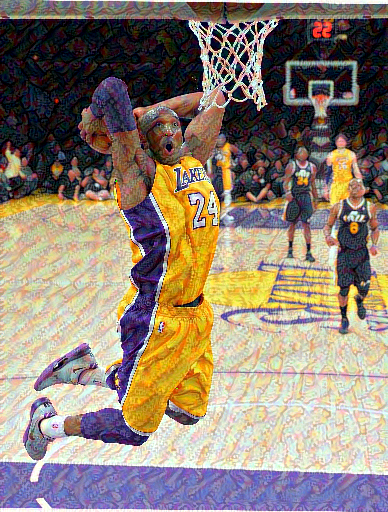

Epoch: 0


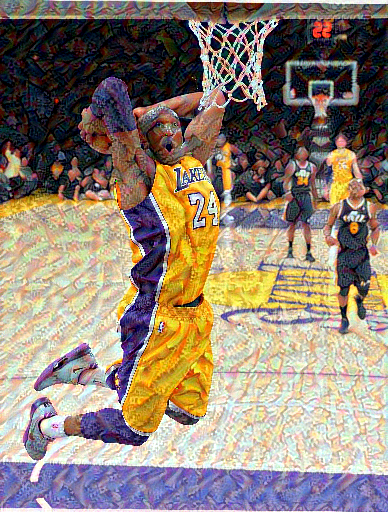

Epoch: 1


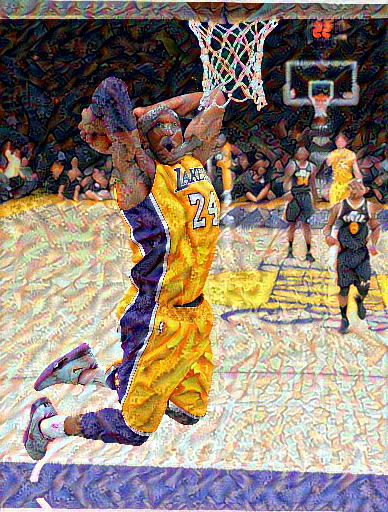

Epoch: 2


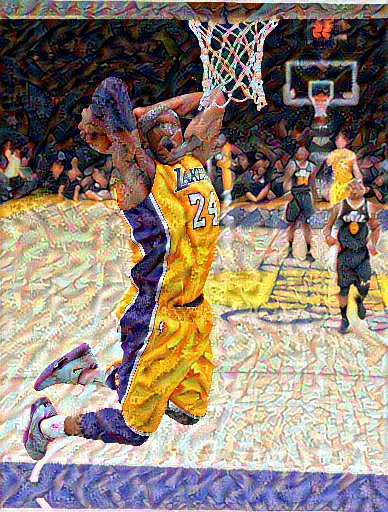

Epoch: 3


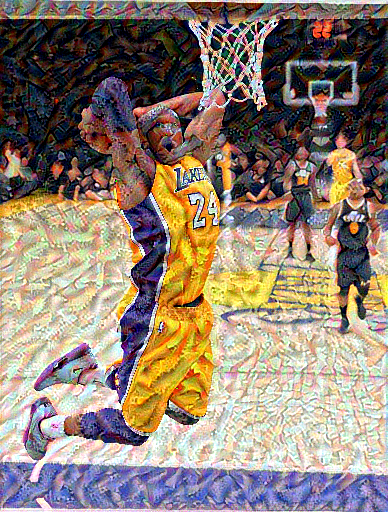

Epoch: 4
Total time: 36.9
imgs/content/landscape.jpg
feature_extractor is now set...
feature_extractor is now set...


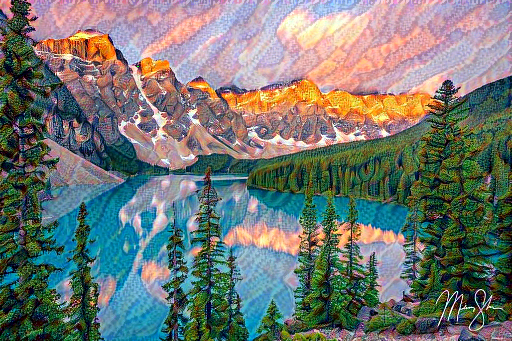

Epoch: 0


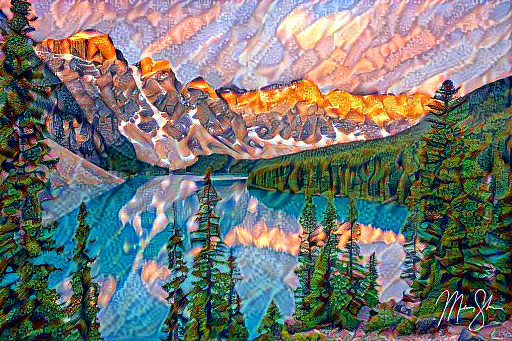

Epoch: 1


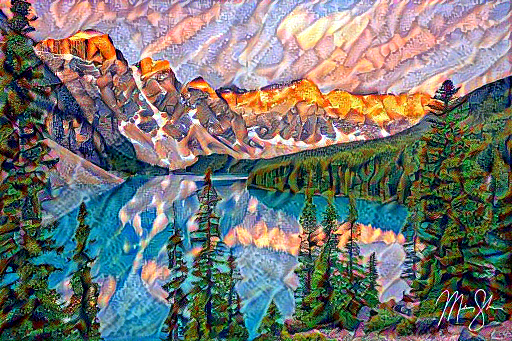

Epoch: 2


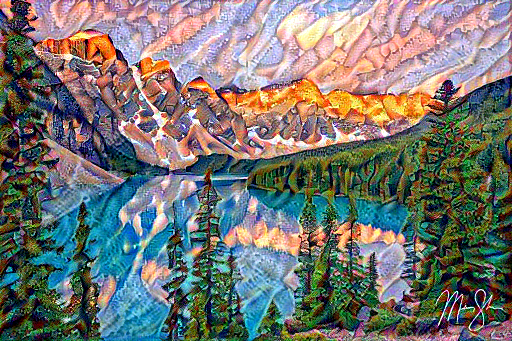

Epoch: 3


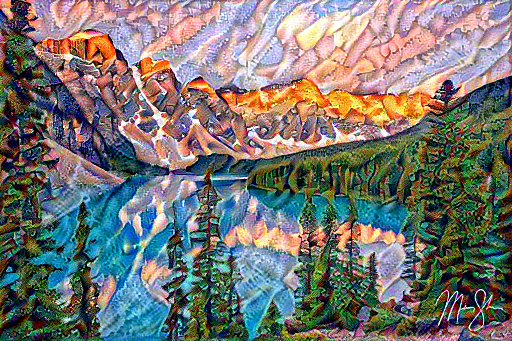

Epoch: 4
Total time: 31.8
imgs/content/portrait.jpg
feature_extractor is now set...
feature_extractor is now set...


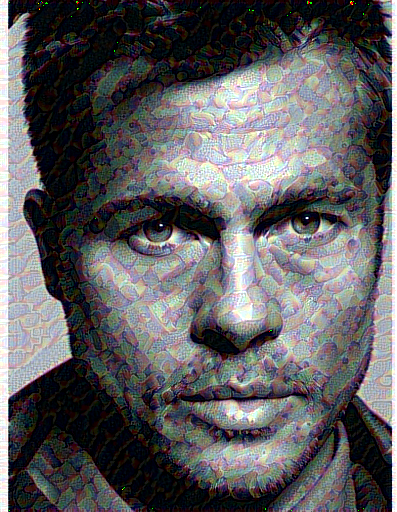

Epoch: 0


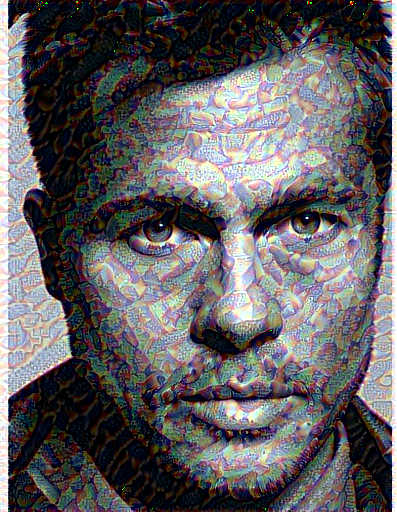

Epoch: 1


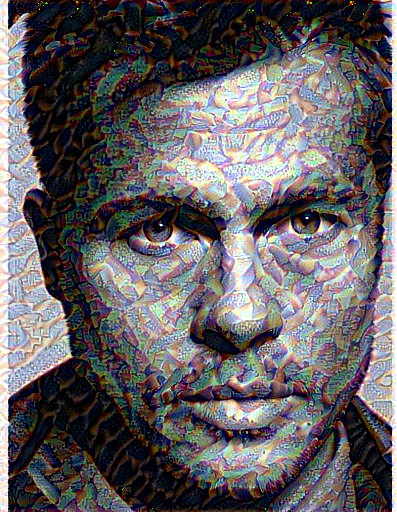

Epoch: 2


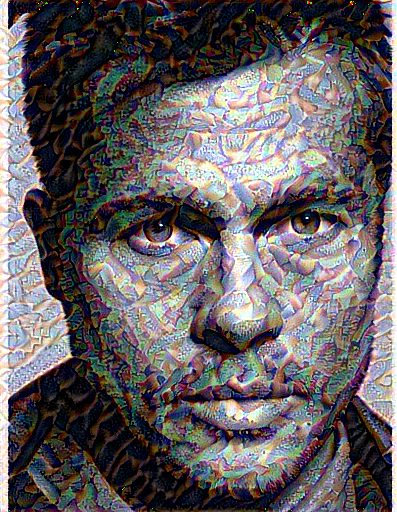

Epoch: 3


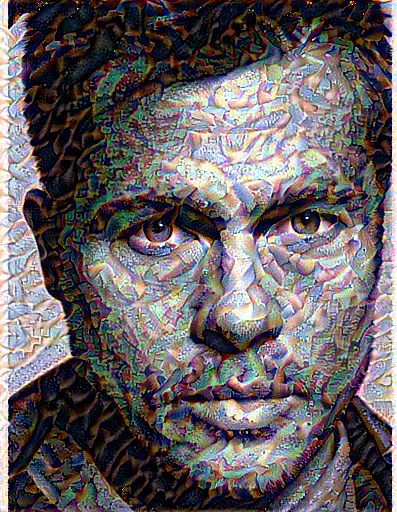

Epoch: 4
Total time: 39.0
imgs/content/cityscape.jpg
feature_extractor is now set...
feature_extractor is now set...


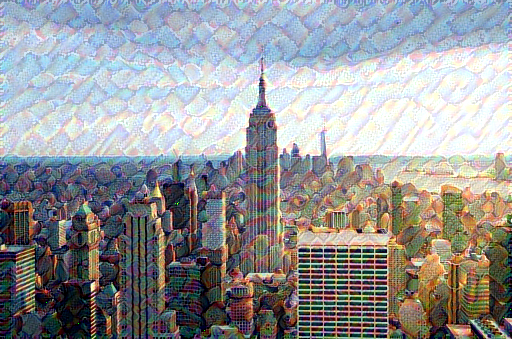

Epoch: 0


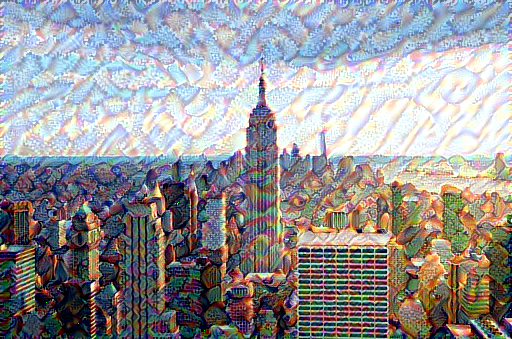

Epoch: 1


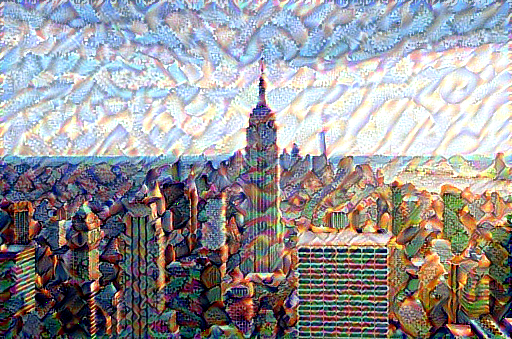

Epoch: 2


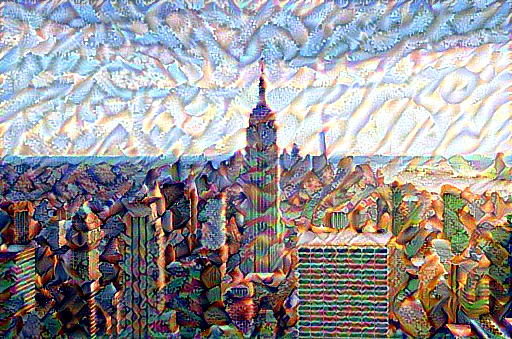

Epoch: 3


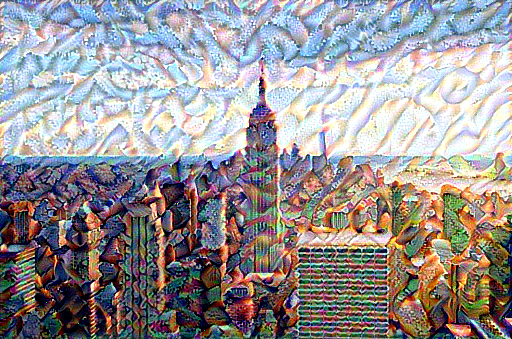

Epoch: 4
Total time: 31.6
imgs/content/Neckarfront.jpg
feature_extractor is now set...
feature_extractor is now set...


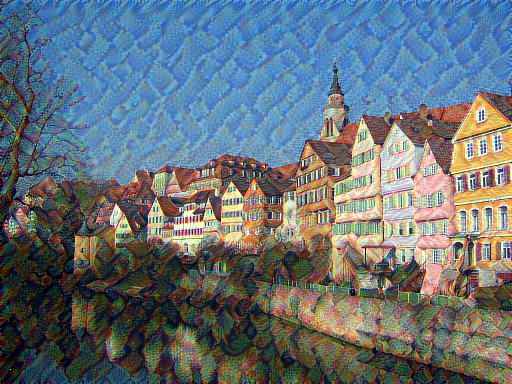

Epoch: 0


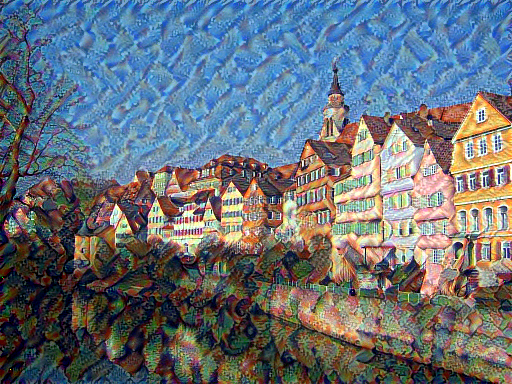

Epoch: 1


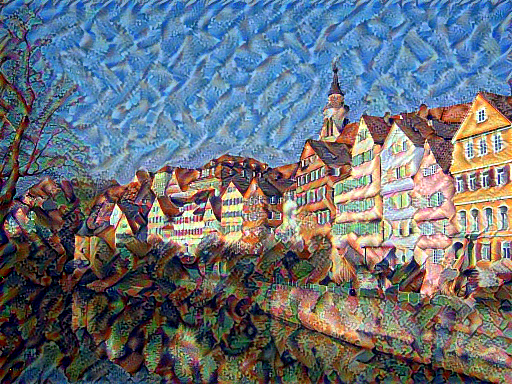

Epoch: 2


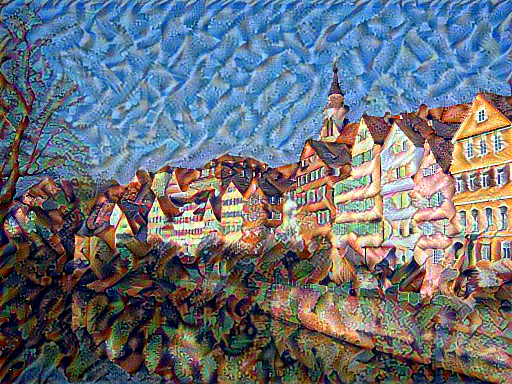

Epoch: 3


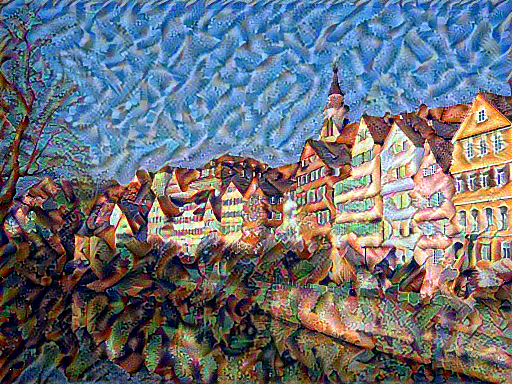

Epoch: 4
Total time: 34.8
imgs/content/kobe.jpg
feature_extractor is now set...
feature_extractor is now set...


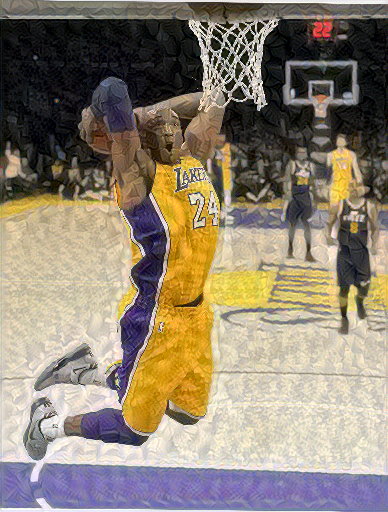

Epoch: 0


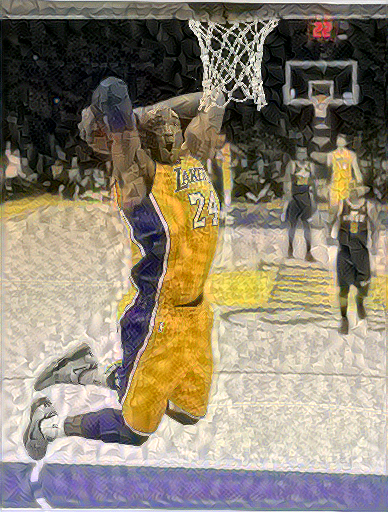

Epoch: 1


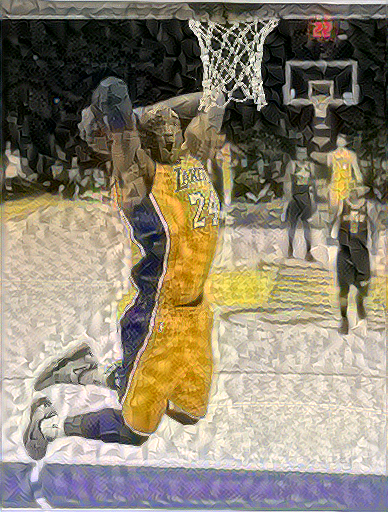

Epoch: 2


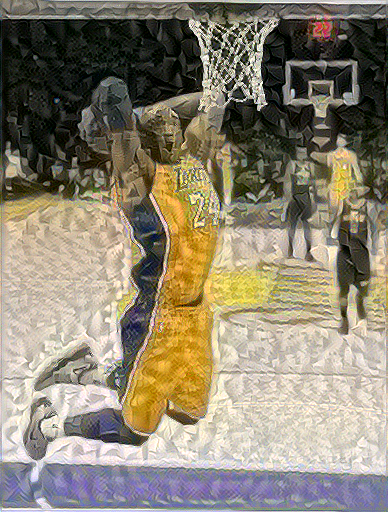

Epoch: 3


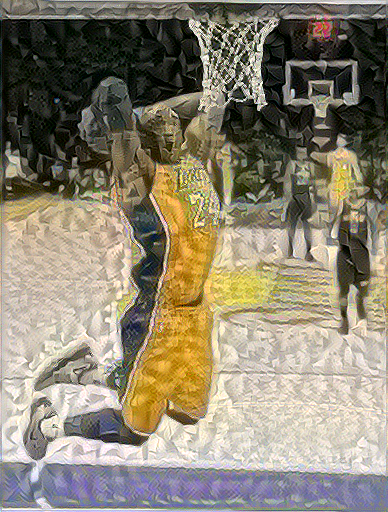

Epoch: 4
Total time: 36.5
imgs/content/landscape.jpg
feature_extractor is now set...
feature_extractor is now set...


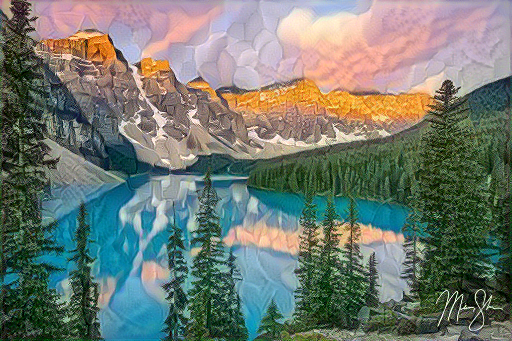

Epoch: 0


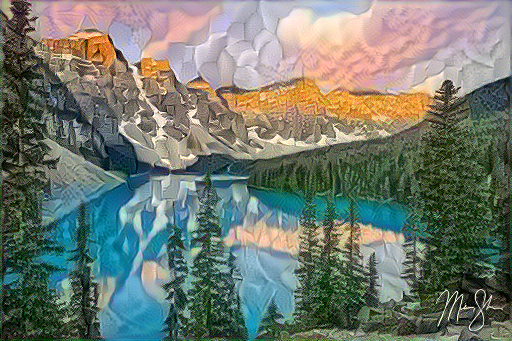

Epoch: 1


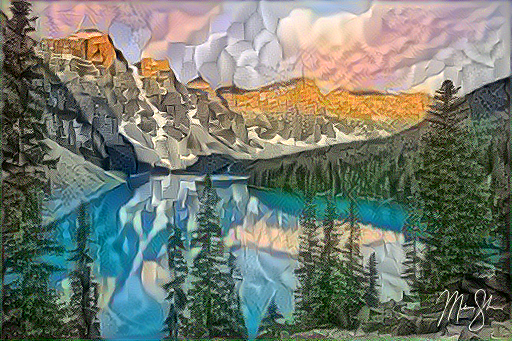

Epoch: 2


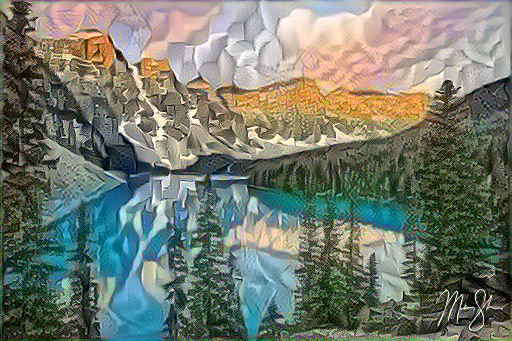

Epoch: 3


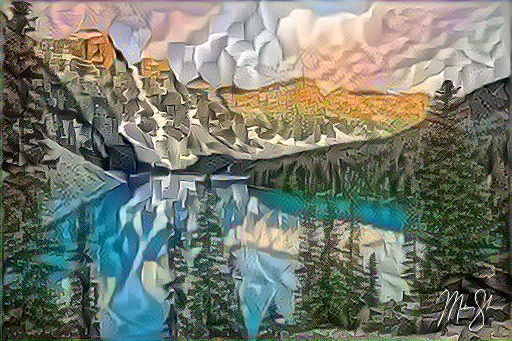

Epoch: 4
Total time: 31.4
imgs/content/portrait.jpg
feature_extractor is now set...
feature_extractor is now set...


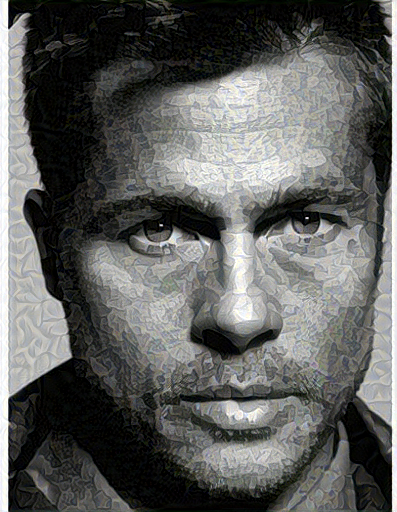

Epoch: 0


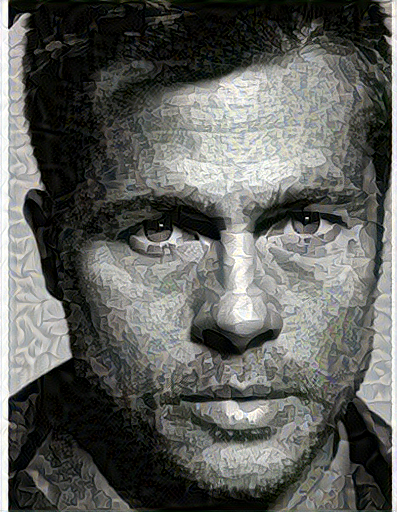

Epoch: 1


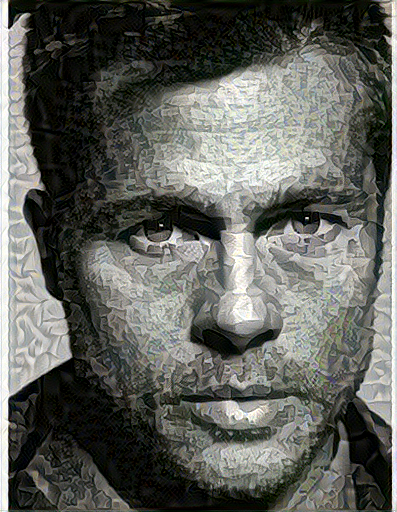

Epoch: 2


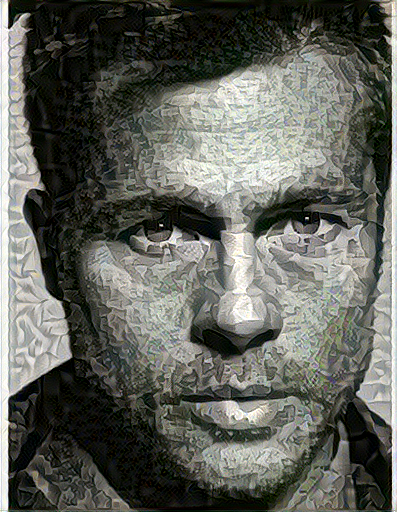

Epoch: 3


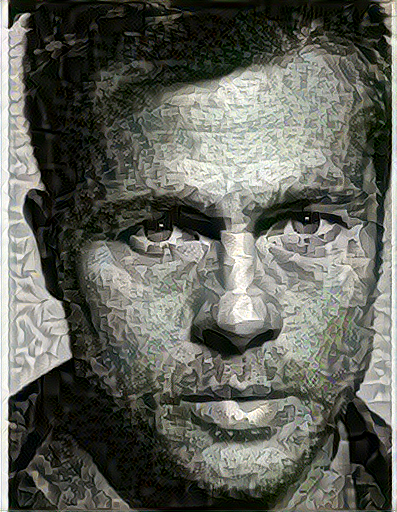

Epoch: 4
Total time: 38.5
imgs/content/cityscape.jpg
feature_extractor is now set...
feature_extractor is now set...


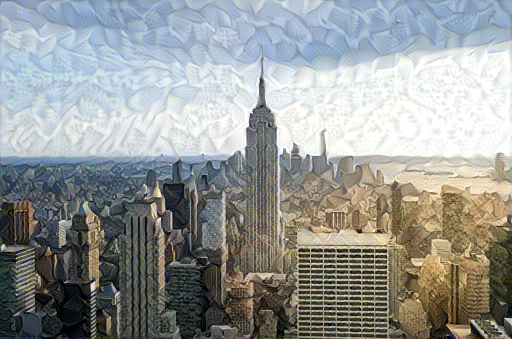

Epoch: 0


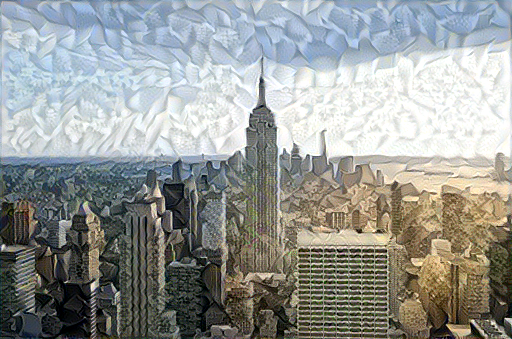

Epoch: 1


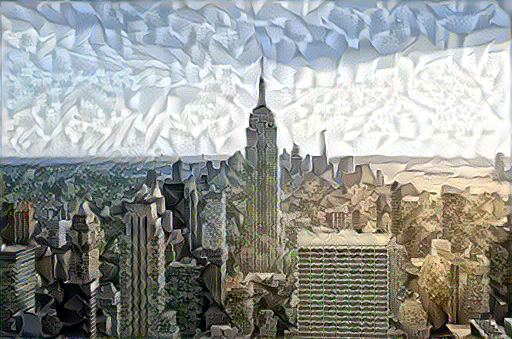

Epoch: 2


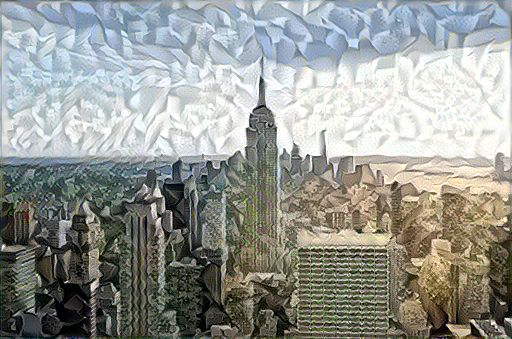

Epoch: 3


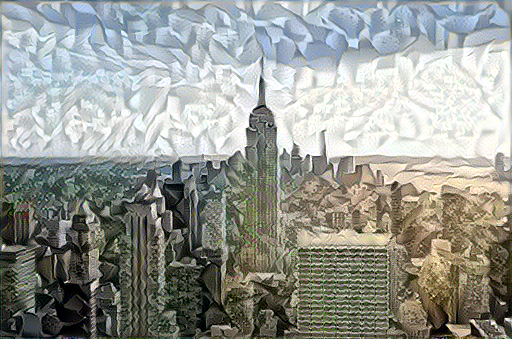

Epoch: 4
Total time: 31.2
imgs/content/Neckarfront.jpg
feature_extractor is now set...
feature_extractor is now set...


ResourceExhaustedError: OOM when allocating tensor with shape[1,48,64,512] and type float on /job:localhost/replica:0/task:0/device:GPU:0 by allocator GPU_0_bfc [Op:RealDiv]

In [2]:
style_stem = "imgs/style"
content_stem = "imgs/content"
output_stem = "imgs/outputs"

style_imgs = os.listdir("imgs/style")
if ".ipynb_checkpoints" in style_imgs:
    style_imgs.remove(".ipynb_checkpoints")
content_imgs = os.listdir("imgs/content")
if ".ipynb_checkpoints" in content_imgs:
    content_imgs.remove(".ipynb_checkpoints")

for style_img in style_imgs:
    for content_img in content_imgs:
        content_path = content_stem + '/' + content_img
        style_path = style_stem + '/' + style_img
        print(style_path)
        print(content_path)
        output_path = output_stem + '/' + style_img[:-4] + '_' + content_img
        arch = arch = arch_obj(optimizer = tf.optimizers.Adam, learning_rate = 0.005,
                 n_epochs=5, n_steps_per_epoch=25, decay = 0) 
        content_object = image_obj(content_path, img_type = 'content',
                           feature_layers = base_content_layers,
                           feature_vector = base_content_weights, color_adj = False)
        style_object = image_obj(style_path, img_type = 'style',
                         feature_layers = base_style_layers,
                         feature_vector = base_style_weights, color_adj = False) 
        run_thru = arch.run_network(content_object, style_object)
        numpy_image = arch.final_img.numpy()
        PIL_image = Image.fromarray(np.uint8(numpy_image[0]*255)).convert('RGB')
        PIL_image.save(output_path)